In [1]:
# Download the Image

!wget https://cf-courses-data.s3.us.cloud-object-storage.appdomain.cloud/IBMDeveloperSkillsNetwork-CV0101EN-SkillsNetwork/images%20/images_part_1/lenna.png -O lenna.png
!wget https://cf-courses-data.s3.us.cloud-object-storage.appdomain.cloud/IBMDeveloperSkillsNetwork-CV0101EN-SkillsNetwork/images%20/images_part_1/baboon.png -O baboon.png
!wget https://cf-courses-data.s3.us.cloud-object-storage.appdomain.cloud/IBMDeveloperSkillsNetwork-CV0101EN-SkillsNetwork/images%20/images_part_1/barbara.png -O barbara.png
!wget https://cf-courses-data.s3.us.cloud-object-storage.appdomain.cloud/IBMDeveloperSkillsNetwork-CV0101EN-SkillsNetwork/images%20/images_part_1/cat.png -O cat.png
!wget https://cf-courses-data.s3.us.cloud-object-storage.appdomain.cloud/IBMDeveloperSkillsNetwork-CV0101EN-SkillsNetwork/images%20/images_part_1/cameraman.jpeg

--2023-08-08 05:36:44--  https://cf-courses-data.s3.us.cloud-object-storage.appdomain.cloud/IBMDeveloperSkillsNetwork-CV0101EN-SkillsNetwork/images%20/images_part_1/lenna.png
Resolving cf-courses-data.s3.us.cloud-object-storage.appdomain.cloud (cf-courses-data.s3.us.cloud-object-storage.appdomain.cloud)... 169.63.118.104
Connecting to cf-courses-data.s3.us.cloud-object-storage.appdomain.cloud (cf-courses-data.s3.us.cloud-object-storage.appdomain.cloud)|169.63.118.104|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 473831 (463K) [image/png]
Saving to: ‘lenna.png’

lenna.png           100%[===================>] 462.73K  --.-KB/s    in 0.1s    

2023-08-08 05:36:45 (3.70 MB/s) - ‘lenna.png’ saved [473831/473831]

--2023-08-08 05:36:45--  https://cf-courses-data.s3.us.cloud-object-storage.appdomain.cloud/IBMDeveloperSkillsNetwork-CV0101EN-SkillsNetwork/images%20/images_part_1/baboon.png
Resolving cf-courses-data.s3.us.cloud-object-storage.appdomain.cloud (cf-cours

In [2]:
# Define a function to concatenate two images side-by-side.

def get_concat_h(im1, im2):
    dst = Image.new('RGB', (im1.width + im2.width, im1.height))
    dst.paste(im1, (0, 0))
    dst.paste(im2, (im1.width, 0))
    return dst

In [3]:
import matplotlib.pyplot as plt
from PIL import Image
import numpy as np

In [ ]:
# Image Files and Paths

my_image = "lenna.png"

In [ ]:
# Note: The `os` module provides functions to interact with the file system, e.g. creating or removing a directory (folder), listing its contents, changing and identifying the current working directory.

In [ ]:
import os
cwd = os.getcwd()
cwd

'/content'

In [ ]:
#The path to an image

image_path = os.path.join(cwd, my_image)
image_path

'/content/lenna.png'

In [ ]:
# Load Images in Python

In [ ]:
from PIL import Image

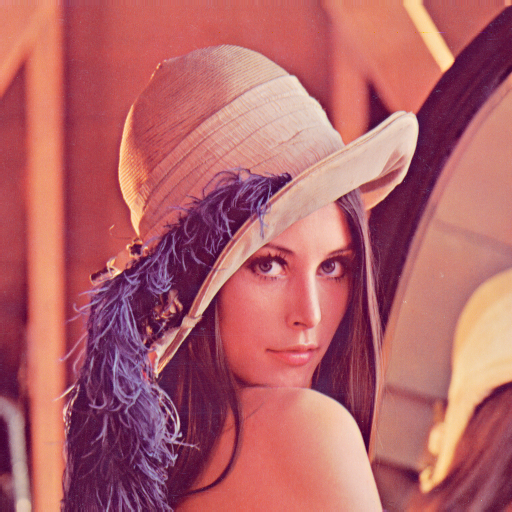

In [ ]:
# Loading the image using the image's filename and create a PIL Image object:
image = Image.open(my_image)
type(image)
image

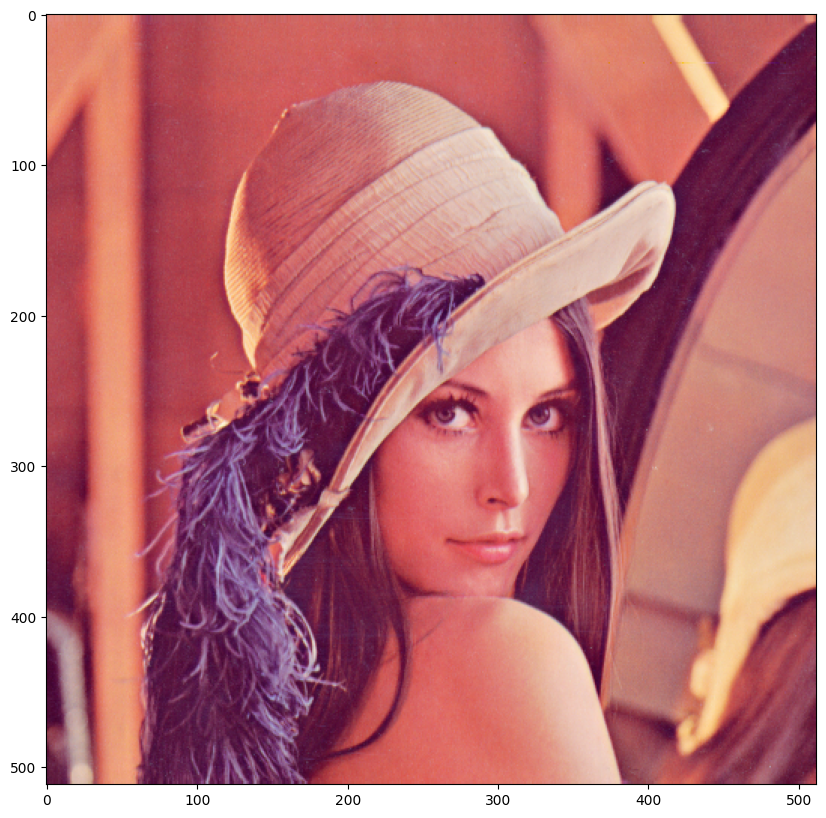

In [ ]:
# ***Plotting an Image using matplatlib***

import matplotlib.pyplot as plt
plt.figure(figsize=(10,10))
plt.imshow(image)

In [ ]:
# We can also load the image using its full path

image = Image.open(image_path)

In [ ]:
# The attribute size returns a tuple, the first element is the number of pixels that comprise the width and the second element is the number of pixels that make up the height of the image
print(image.size)

(512, 512)


In [ ]:
# Mode specify the pixel format used ie., RGB or BGR
print(image.mode)

RGB


In [ ]:
# The Image.open method does not load image data into the computer memory.
# The load method of PIL object reads the file content, decodes it, and expands the image into memory.

im = image.load()


In [ ]:
# checking the intensity of the image at the 𝑥-th column and 𝑦-th row:

x = 0
y = 1
im[y,x]

(226, 137, 125)

In [ ]:
# To save an image use

image.save("lenna.jpg")

In [ ]:
# ***Grayscale Images, Quantization and Color Channels***

# The ImageOps module contains several ‘ready-made’ image processing operations.
from PIL import ImageOps

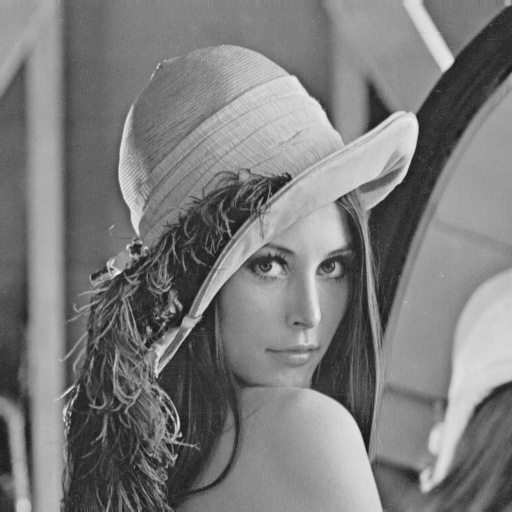

In [ ]:
image_gray = ImageOps.grayscale(image)
image_gray

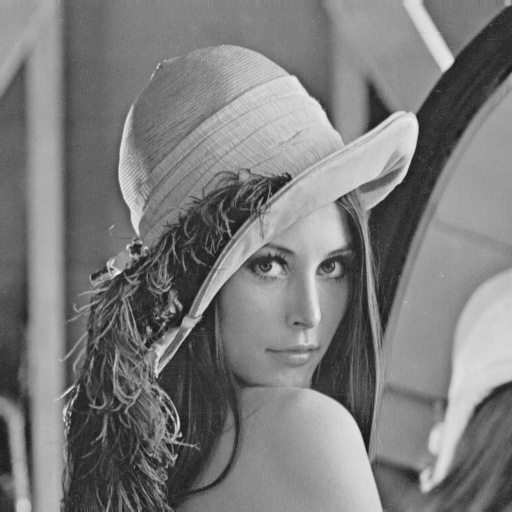

In [ ]:
# **Quantization**
# The Quantization of an image is the number of unique intensity values any given pixel of the image can take.
# For a grayscale image, this means the number of different shades of gray. Most images have 256 different levels.
# Decrease the levels using the method quantize

# Half the level
image_gray.quantize(256 // 2)
image_gray

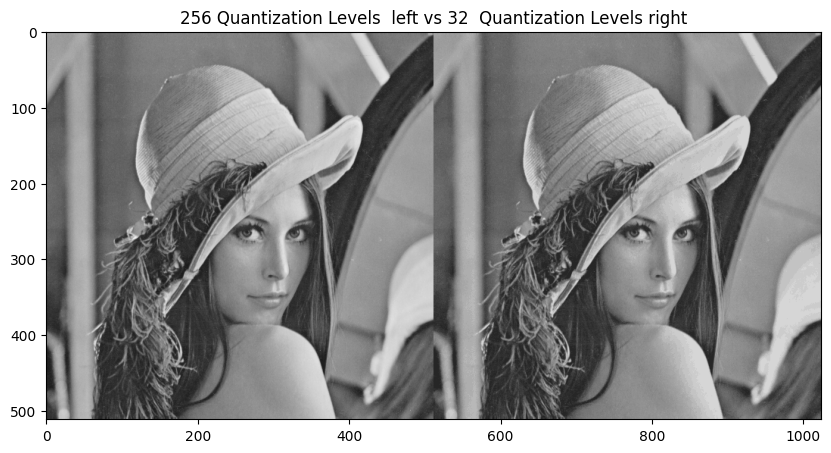

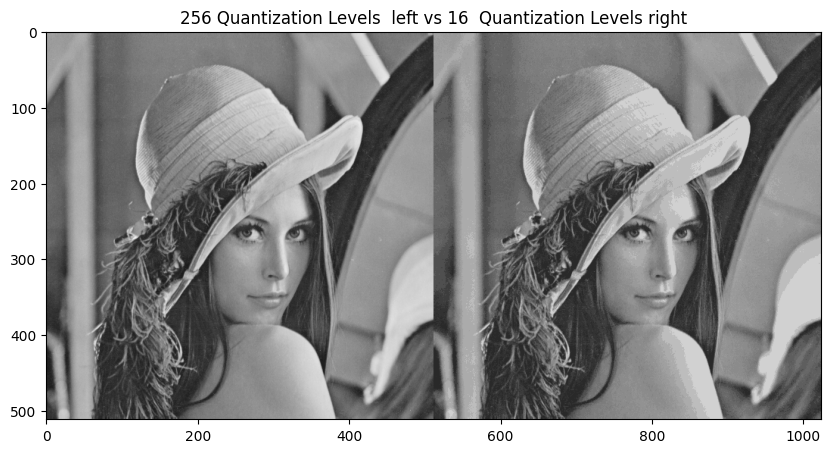

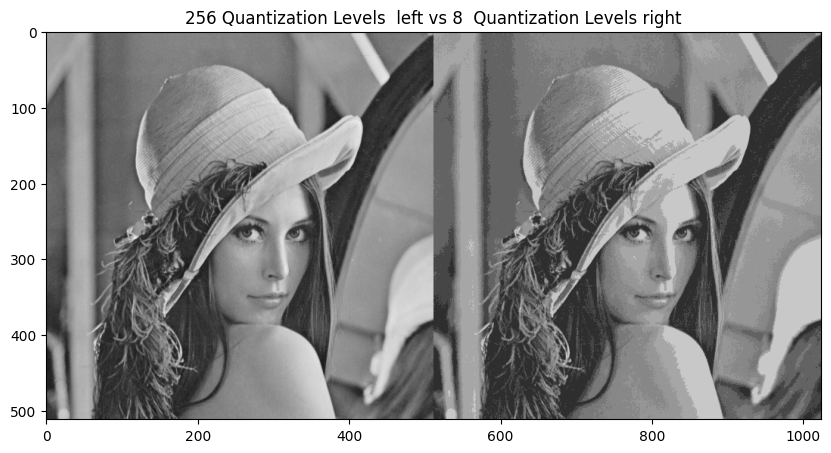

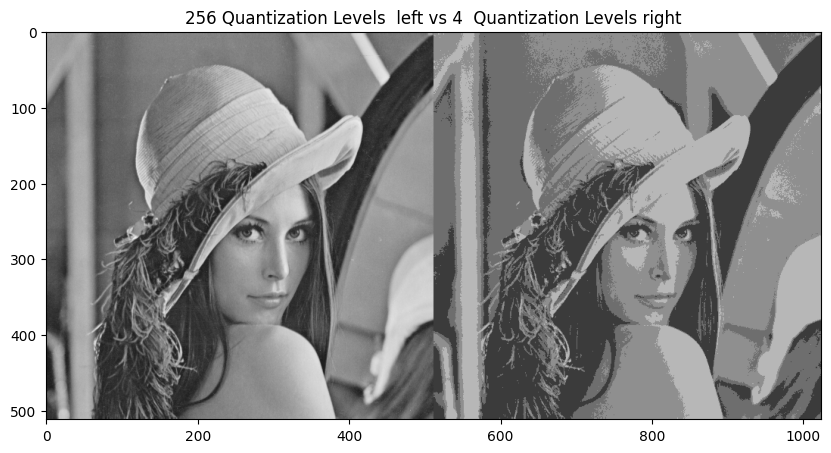

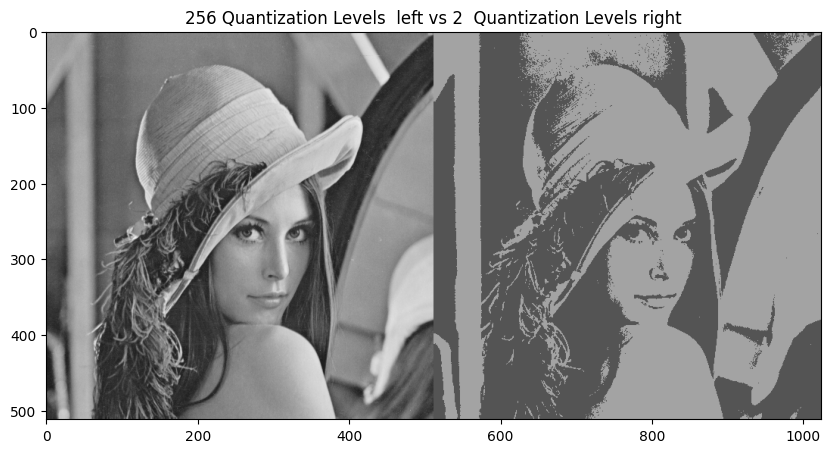

In [ ]:
# Continue dividing the number of values by two and compare it to the original image.

for n in range(3,8):
    plt.figure(figsize=(10,10))
    plt.imshow(get_concat_h(image_gray,  image_gray.quantize(256//2**n)))
    plt.title("256 Quantization Levels  left vs {}  Quantization Levels right".format(256//2**n))
    plt.show()

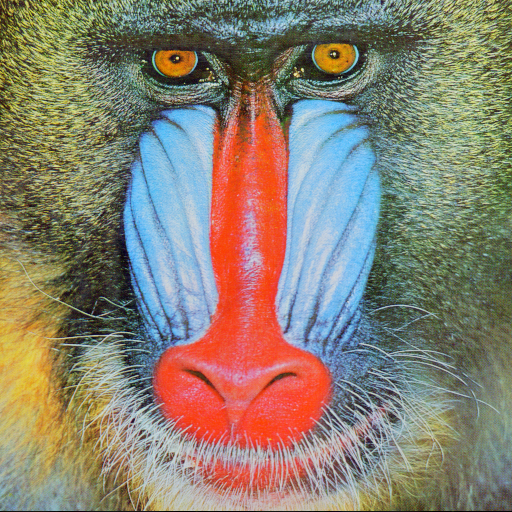

In [ ]:
# ** Color Channels **

baboon = Image.open('baboon.png')
baboon

In [ ]:
# Spliting different RGB color channels and assign them to the variables red, green, and blue
red, green, blue = baboon.split()

In [ ]:
# Plotting the color image next to the red channel as a grayscale, we see that regions with red have higher intensity values.
get_concat_h(baboon, red)

NameError: ignored

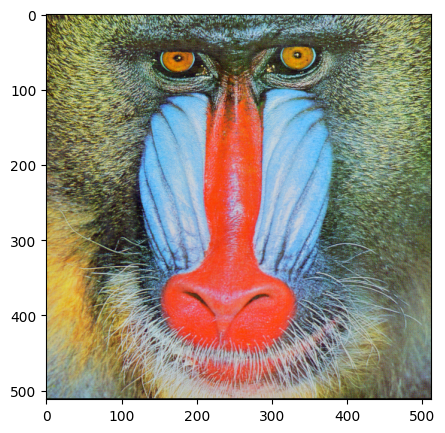

In [ ]:
# ** Copying Images **

# Reassign an array to another variable, you should use the copy method.
baboon = np.array(Image.open('baboon.png'))
plt.figure(figsize=(5,5))
plt.imshow(baboon )

In [ ]:
# If we do not apply the method copy(), the two variables would point to the same location in memory:
A = baboon
# We use the id function to find a variable's memory address
id(A) == id(baboon)

True

In [ ]:
# Appling method copy(), their memory addresses are different

B = baboon.copy()
id(B)==id(baboon)

False

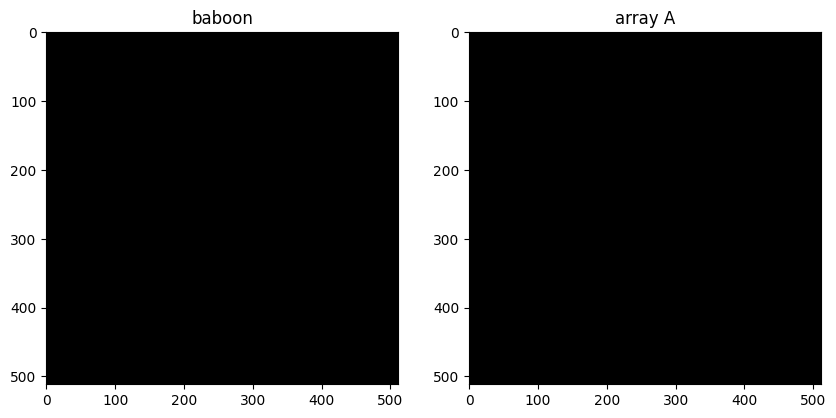

In [ ]:
baboon[:,:,] = 0
# compare the variables baboon and array A
plt.figure(figsize=(10,10))
plt.subplot(121)
plt.imshow(baboon)
plt.title("baboon")
plt.subplot(122)
plt.imshow(A)
plt.title("array A")
plt.show()

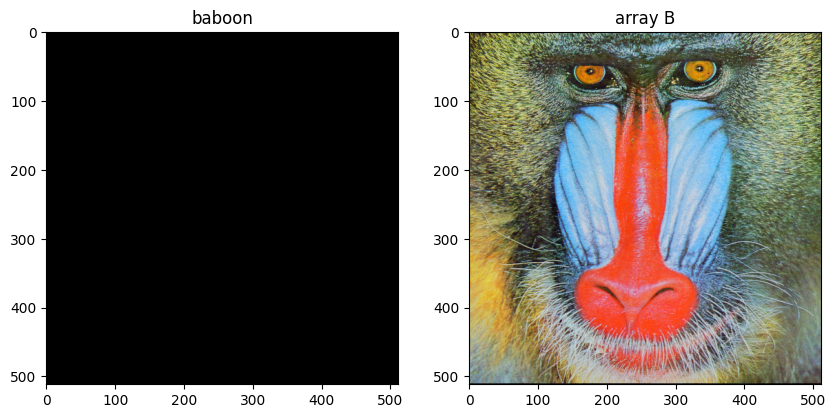

In [ ]:
# compare baboon and array B
plt.figure(figsize=(10,10))
plt.subplot(121)
plt.imshow(baboon)
plt.title("baboon")
plt.subplot(122)
plt.imshow(B)
plt.title("array B")
plt.show()

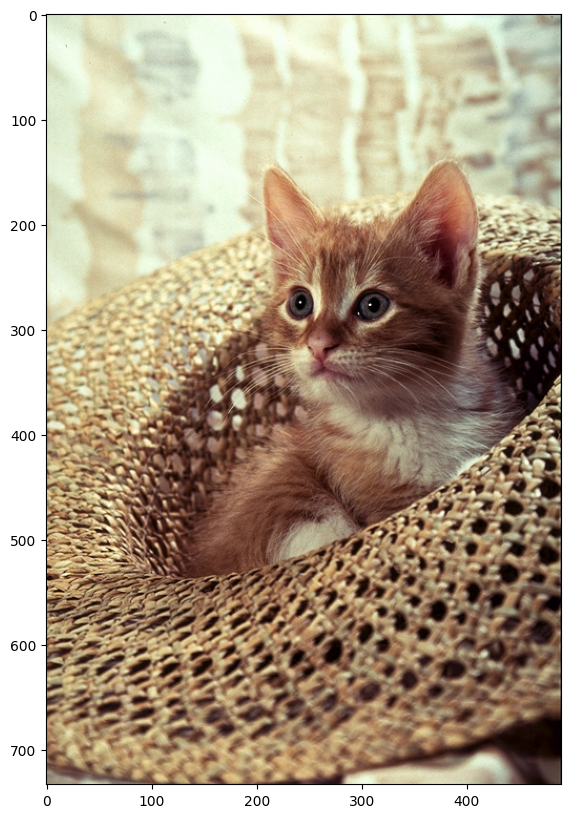

In [ ]:
# ** Flipping Images **

image = Image.open("cat.png")
plt.figure(figsize=(10,10))
plt.imshow(image)

In [ ]:
# cast it to an array and find its shape:
array = np.array(image)
width, height, C = array.shape
print('width, height, C', width, height, C)

width, height, C 733 490 3


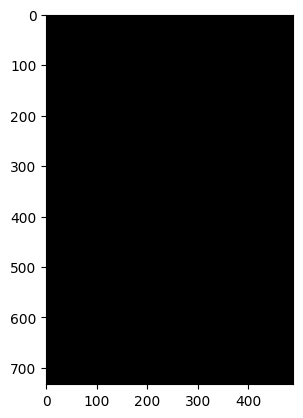

In [ ]:
# Rotating image First Approach

# Rotate vertically, the image.First create an array of the same size with datatype np.uint8
array_flip = np.zeros((width, height, C), dtype=np.uint8)
plt.imshow(array_flip)

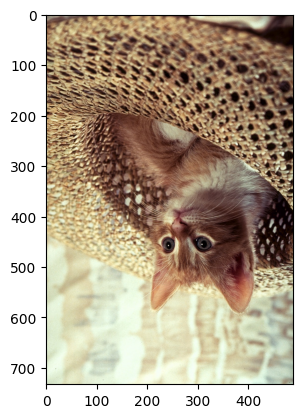

In [ ]:
# Assign the first row of pixels of the original array to the new array’s last row, repeat the process for every row,
# incrementing the row number from the original array and decreasing the new array’s row index to assign the pixels accordingly.
for i,row in enumerate(array):
    array_flip[width - 1 - i, :, :] = row

plt.imshow(array_flip)

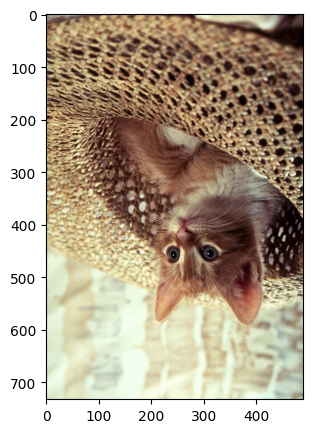

In [ ]:
# Second Approach

from PIL import ImageOps
im_flip = ImageOps.flip(image)
plt.figure(figsize=(5,5))
plt.imshow(im_flip)

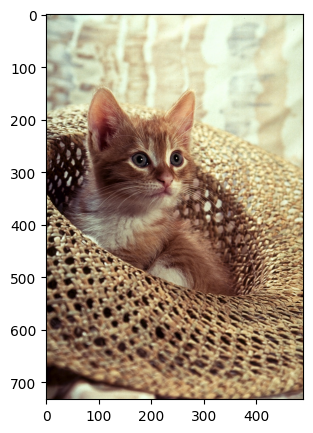

In [ ]:
# Mirror image
im_mirror = ImageOps.mirror(image)
plt.figure(figsize=(5,5))
plt.imshow(im_mirror)

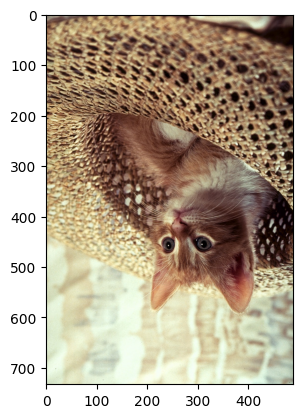

In [ ]:
 # Use transpose() method; the parameter is an integer indicating what type of transposition we would like to perform. For example, flip the image using a value of 1
im_flip = image.transpose(1)
plt.imshow(im_flip)

In [ ]:
# The Image module has built-in attributes that describe the type of flip. The values are just integers. Several are shown in the following dict
flip = {"FLIP_LEFT_RIGHT": Image.FLIP_LEFT_RIGHT,
        "FLIP_TOP_BOTTOM": Image.FLIP_TOP_BOTTOM,
        "ROTATE_90": Image.ROTATE_90,
        "ROTATE_180": Image.ROTATE_180,
        "ROTATE_270": Image.ROTATE_270,
        "TRANSPOSE": Image.TRANSPOSE,
        "TRANSVERSE": Image.TRANSVERSE}

In [ ]:
# values are integers.
flip["FLIP_LEFT_RIGHT"]

0

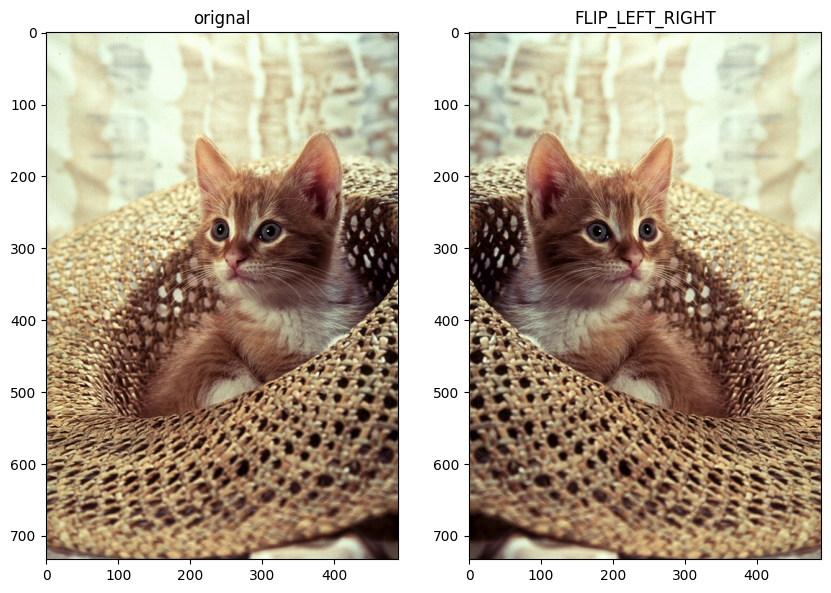

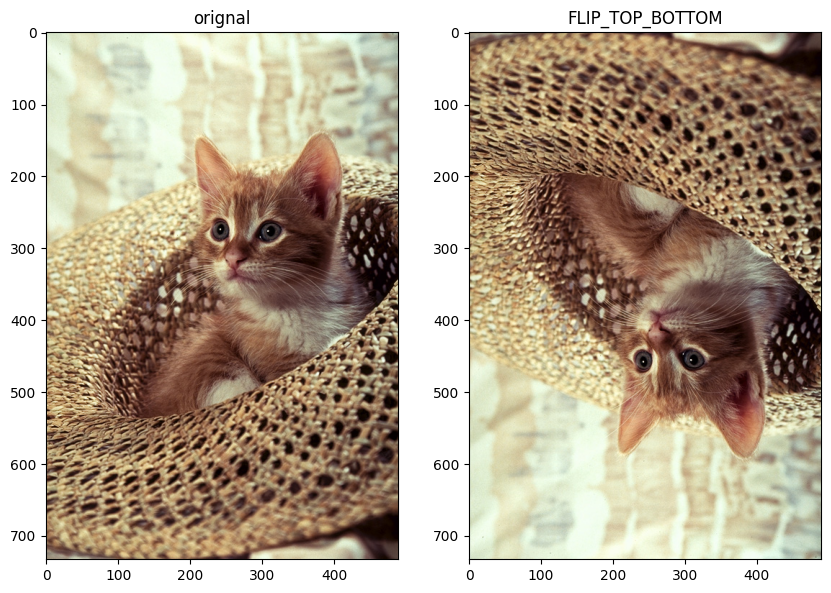

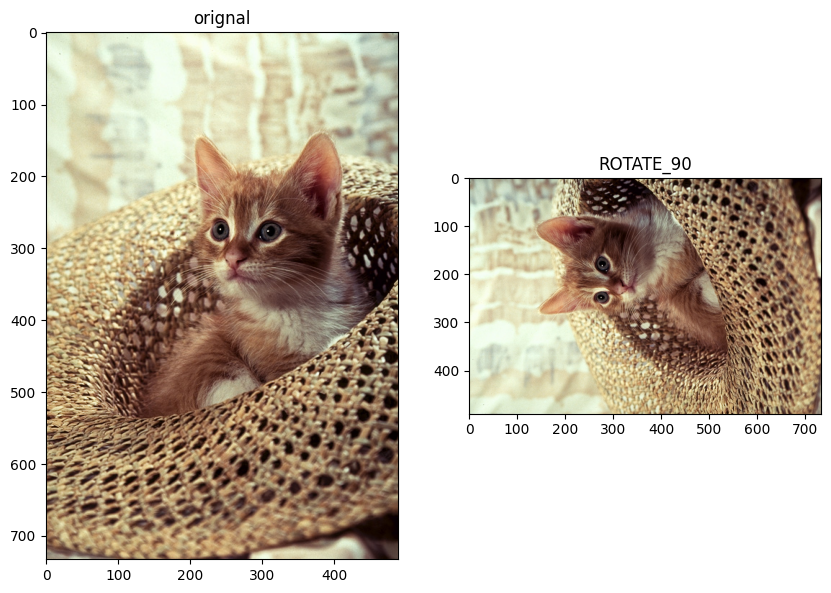

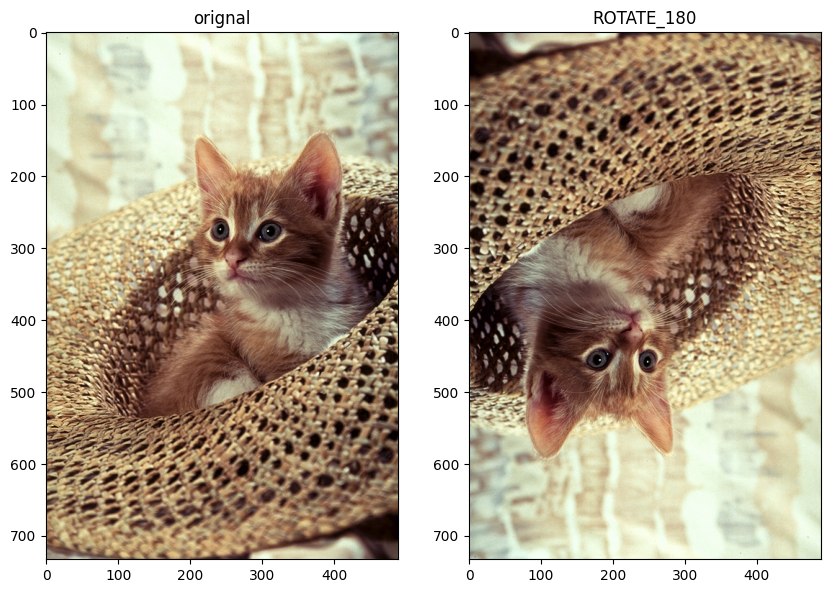

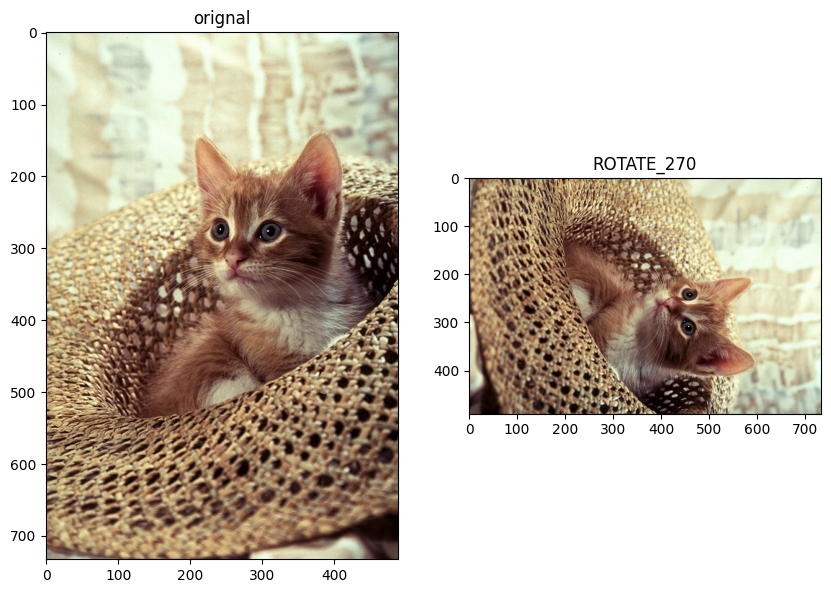

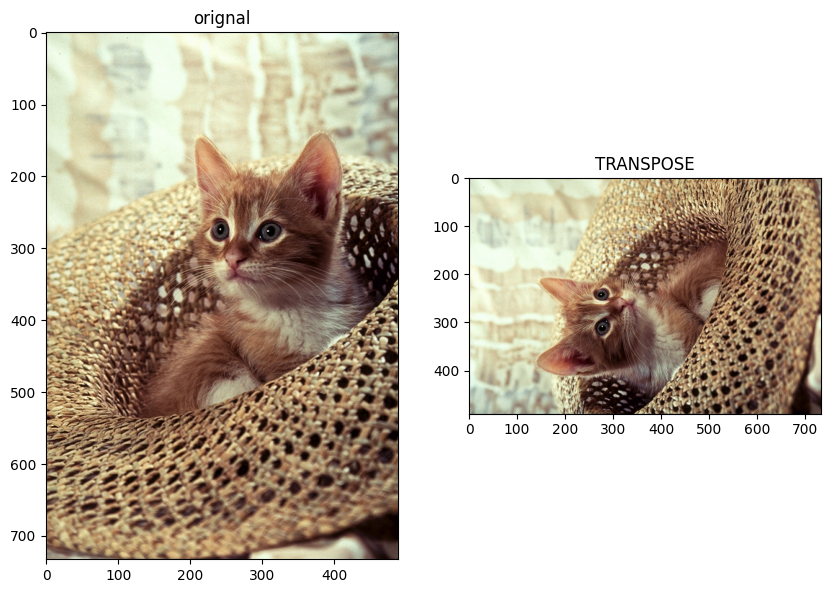

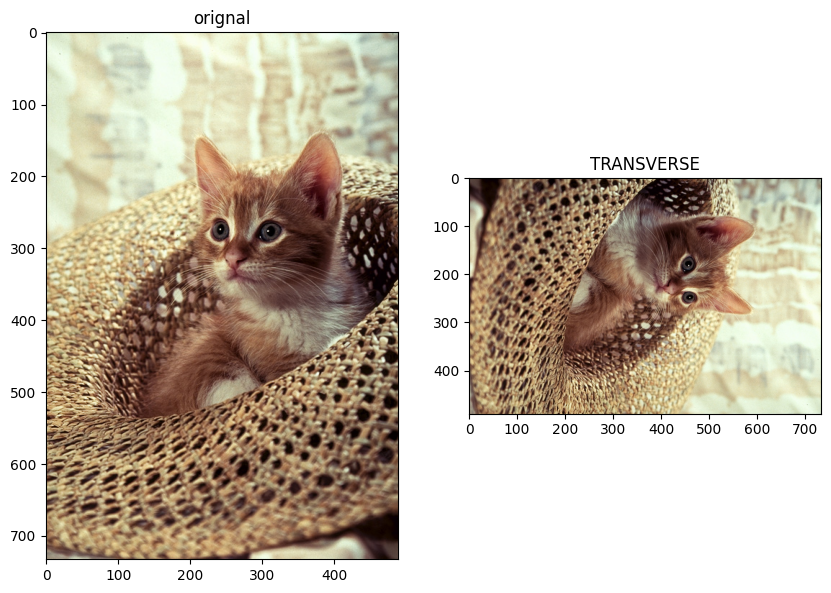

In [ ]:
for key, values in flip.items():
    plt.figure(figsize=(10,10))
    plt.subplot(1,2,1)
    plt.imshow(image)
    plt.title("orignal")
    plt.subplot(1,2,2)
    plt.imshow(image.transpose(values))
    plt.title(key)

In [4]:
# ******* Spatial Operations *******

In [5]:
# This function plot the image side by side

def plot_image(image_1, image_2,title_1="Orignal",title_2="New Image"):
    plt.figure(figsize=(10,10))
    plt.subplot(1, 2, 1)
    plt.imshow(image_1)
    plt.title(title_1)
    plt.subplot(1, 2, 2)
    plt.imshow(image_2)
    plt.title(title_2)
    plt.show()

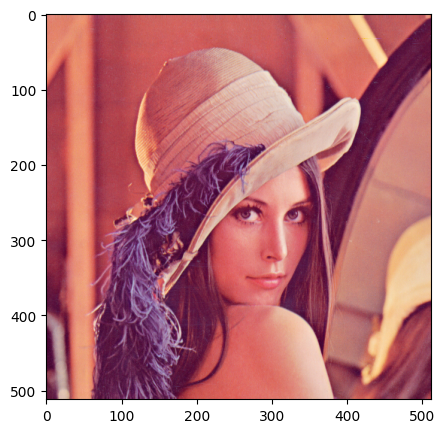

In [6]:
# Loads the image from the specified file
image = Image.open("lenna.png")
# Renders the image
plt.figure(figsize=(5,5))
plt.imshow(image)
plt.show()

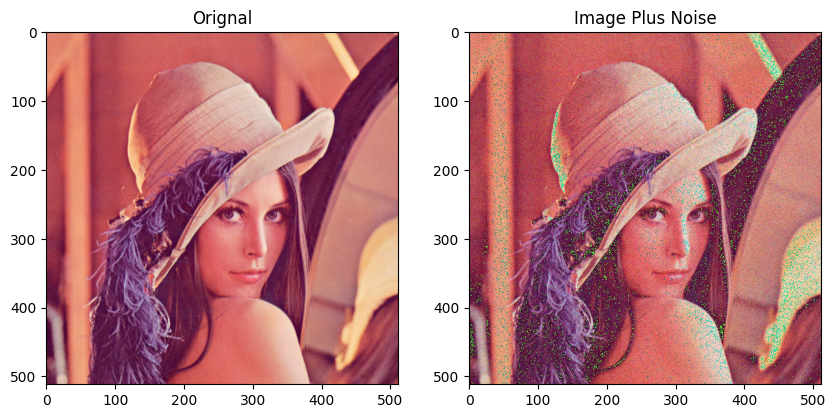

In [7]:
# Note: uint8 type covers the range from 0 to 255. Negative values that are out of this range become 255.

# Get the number of rows and columns in the image
rows, cols = image.size
# Creates values using a normal distribution with a mean of 0 and standard deviation of 15, the values are converted to unit8 which means the values are between 0 and 255
noise = np.random.normal(0,15,(rows,cols,3)).astype(np.uint8)
# Add the noise to the image
noisy_image = image + noise
# Creates a PIL Image from an array
noisy_image = Image.fromarray(noisy_image)
# Plots the original image and the image with noise using the function defined at the top
plot_image(image, noisy_image, title_1="Orignal", title_2="Image Plus Noise")

In [8]:
# When adding noise to an image sometimes the value might be greater than 255, in this case 256, is subtracted from the value to wrap the number around keeping it between 0 and 255.
# For example, consider an image with an RGB value of 137 and we add noise with an RGB value of 215 to get an RGB value of 352.

In [10]:
# **Filtering Noise**
from PIL import ImageFilter

In [11]:
# Create a kernel which is a 5 by 5 array where each value is 1/36
kernel = np.ones((5,5))/36
# Create a ImageFilter Kernel by providing the kernel size and a flattened kernel
kernel_filter = ImageFilter.Kernel((5,5), kernel.flatten())

In [12]:
# The function filter performs a convolution between the image and the kernel on each color channel independently.
# Filters the images using the kernel
image_filtered = noisy_image.filter(kernel_filter)

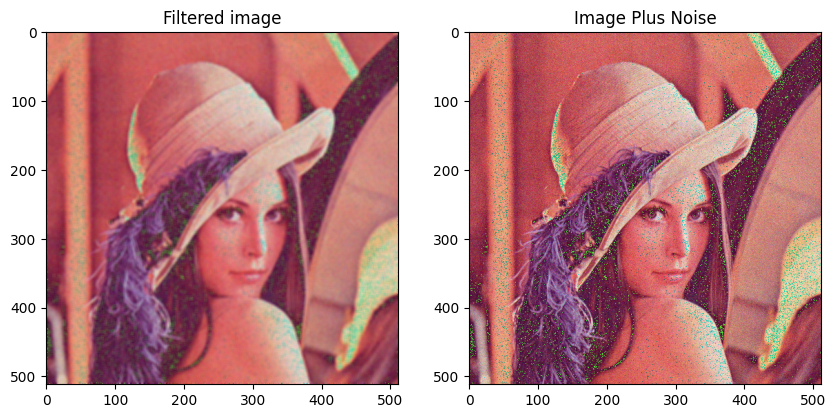

In [13]:
plot_image(image_filtered, noisy_image,title_1="Filtered image",title_2="Image Plus Noise")

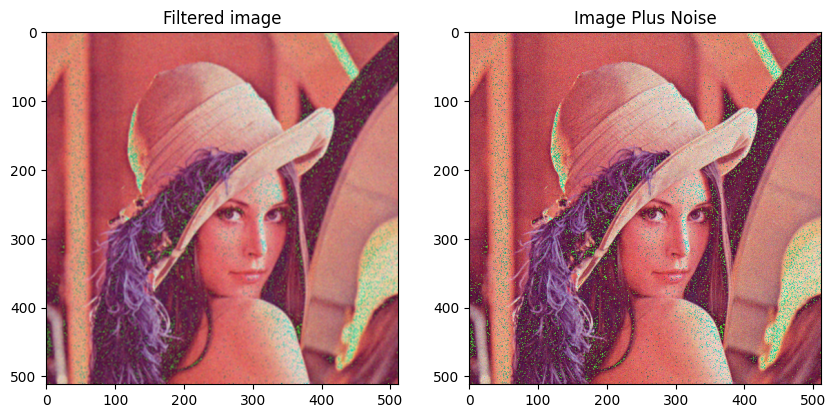

In [14]:
# Here we try a 3x3 kernel. You can see her shoulders are sharper in this image but the green noise is brighter than the filtered image above.
# Create a kernel which is a 3 by 3 array where each value is 1/36
kernel = np.ones((3,3))/36
# Create a ImageFilter Kernel by providing the kernel size and a flattened kernel
kernel_filter = ImageFilter.Kernel((3,3), kernel.flatten())
# Filters the images using the kernel
image_filtered = noisy_image.filter(kernel_filter)
# Plots the Filtered and Image with Noise using the function defined at the top
plot_image(image_filtered, noisy_image,title_1="Filtered image",title_2="Image Plus Noise")

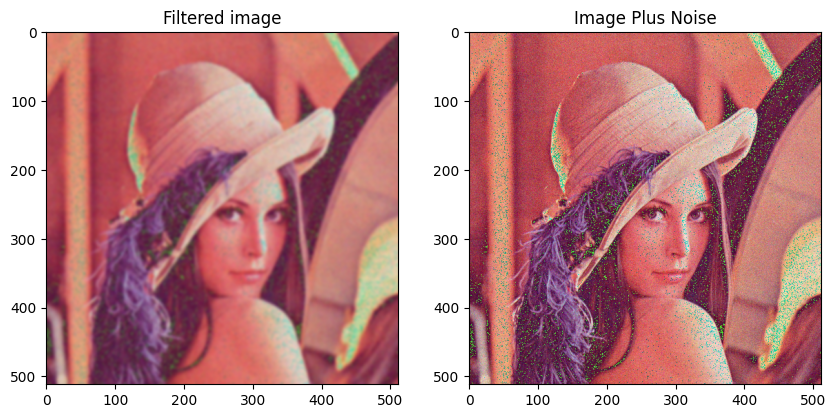

In [15]:
# Using Gaussian Blur
# Prarameter: radius: blur kernel radius, default 2

# Filters the images using GaussianBlur
image_filtered = noisy_image.filter(ImageFilter.GaussianBlur)
# Plots the Filtered Image then the Unfiltered Image with Noise
plot_image(image_filtered , noisy_image,title_1="Filtered image",title_2="Image Plus Noise")

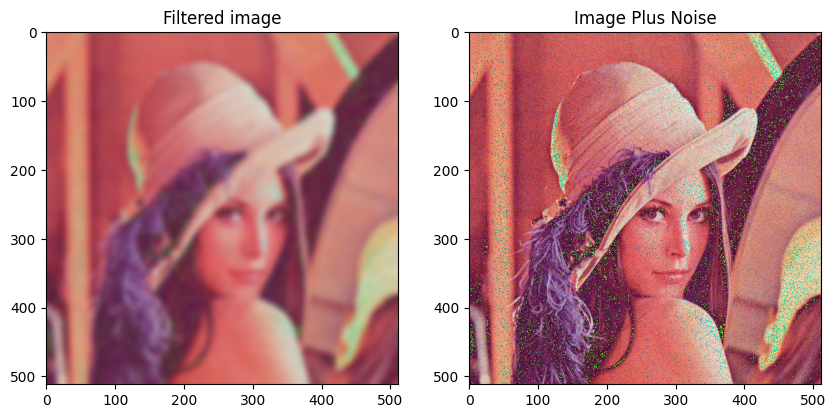

In [16]:
# Filters the images using GaussianBlur on the image with noise using a 4 by 4 kernel
image_filtered = noisy_image.filter(ImageFilter.GaussianBlur(4))
# Plots the Filtered Image then the Unfiltered Image with Noise
plot_image(image_filtered , noisy_image,title_1="Filtered image",title_2="Image Plus Noise")

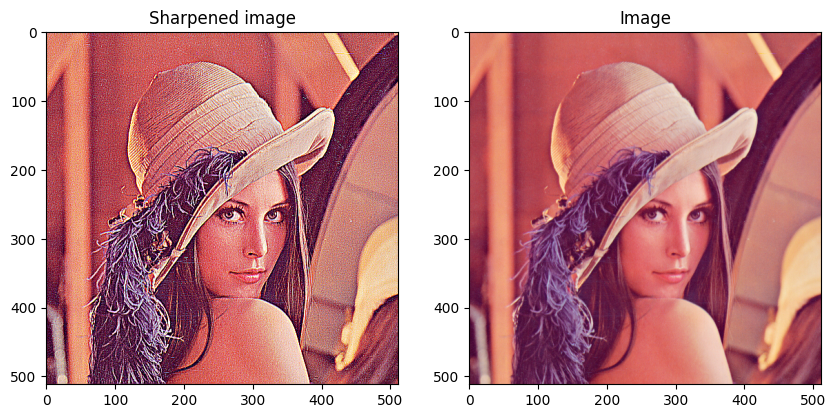

In [17]:
# ** Image Sharpening **

# Common Kernel for image sharpening
kernel = np.array([[-1,-1,-1],
                   [-1, 9,-1],
                   [-1,-1,-1]])
kernel = ImageFilter.Kernel((3,3), kernel.flatten())
# Applys the sharpening filter using kernel on the original image without noise
sharpened = image.filter(kernel)
# Plots the sharpened image and the original image without noise
plot_image(sharpened , image, title_1="Sharpened image",title_2="Image")

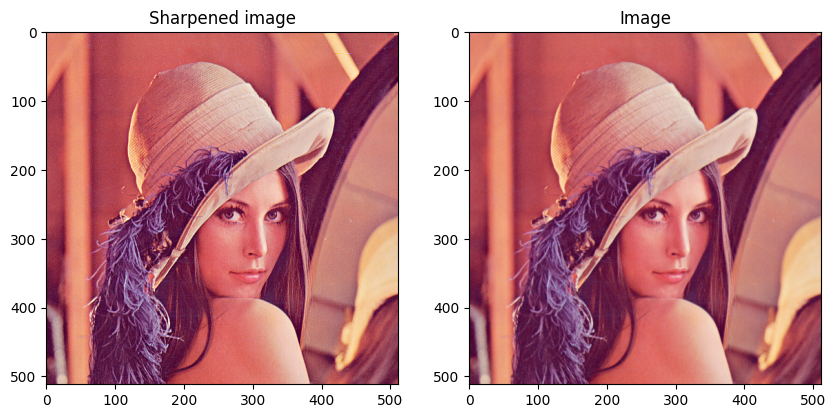

In [18]:
# OR Using Predifined function

# Sharpends image using predefined image filter from PIL
sharpened = image.filter(ImageFilter.SHARPEN)  # --------------->> We can also Sharp the image by enhancing the edge of image using   (ImageFilter.EDGE_ENHANCE)
# Plots the sharpened image and the original image without noise
plot_image(sharpened , image, title_1="Sharpened image",title_2="Image")

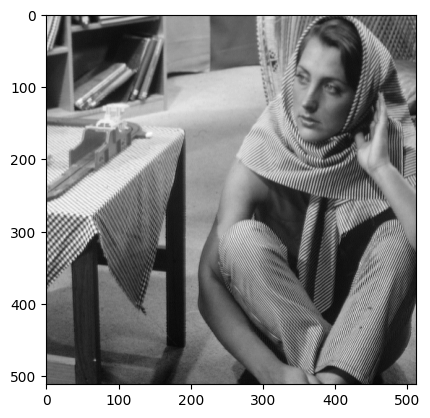

In [19]:
# *** Edges ****

# Loads the image from the specified file
img_gray = Image.open('barbara.png')
# Renders the image from the array of data, notice how it is 2 diemensional instead of 3 diemensional because it has no color
plt.imshow(img_gray ,cmap='gray')


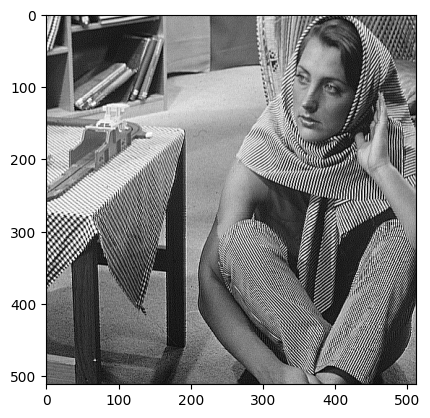

In [20]:
# Filters the images using EDGE_ENHANCE filter
img_gray = img_gray.filter(ImageFilter.EDGE_ENHANCE)
# Renders the enhanced image
plt.imshow(img_gray ,cmap='gray')

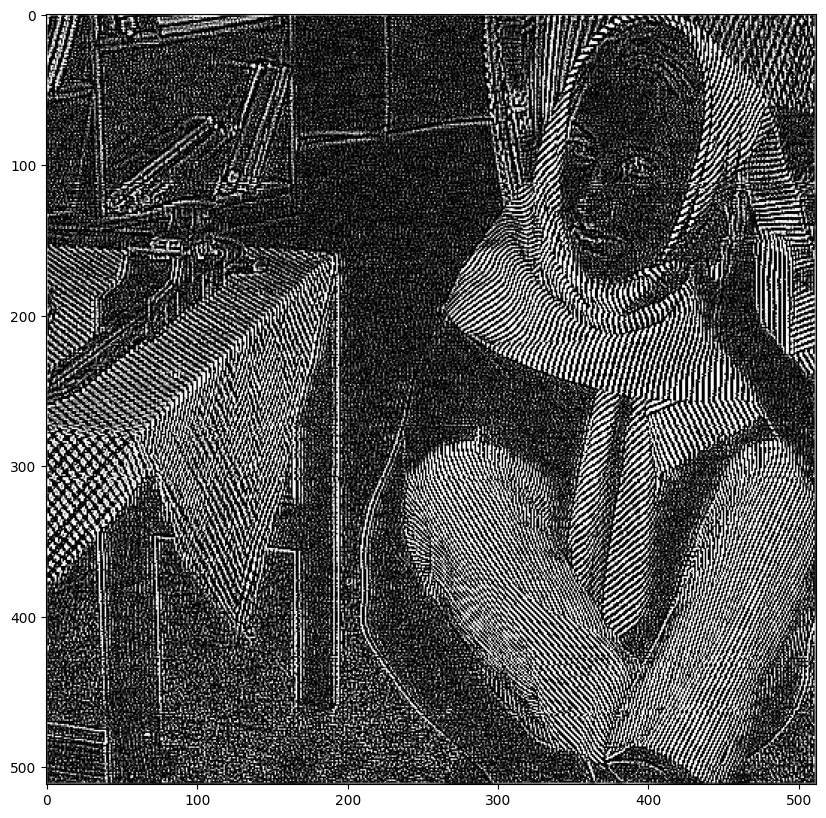

In [21]:
# Filters the images using FIND_EDGES filter
img_gray = img_gray.filter(ImageFilter.FIND_EDGES)
# Renders the filtered image
plt.figure(figsize=(10,10))
plt.imshow(img_gray ,cmap='gray')

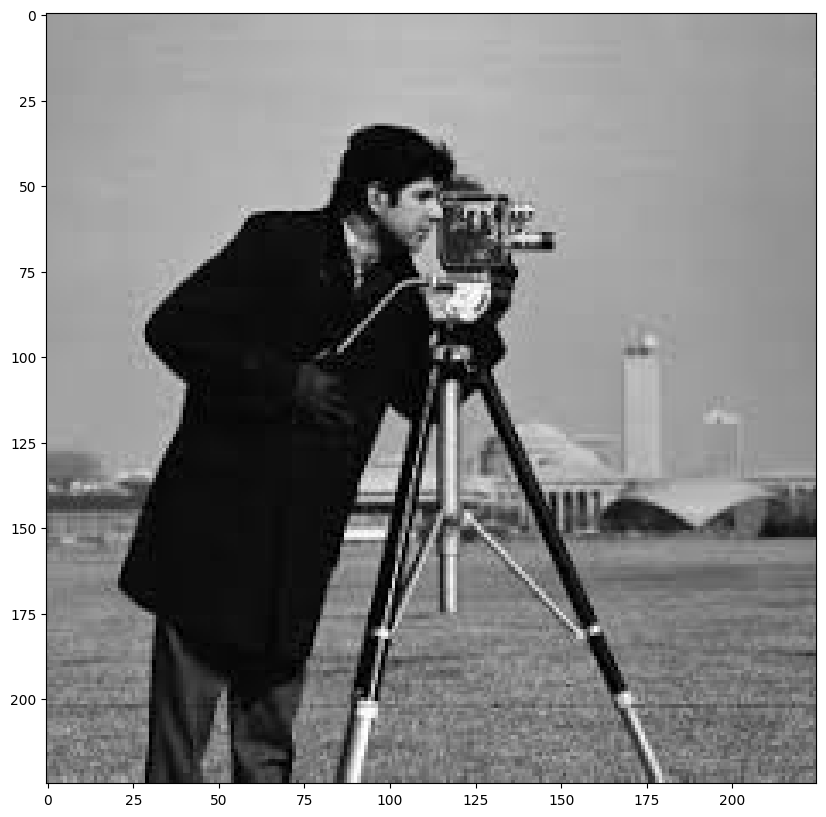

In [22]:
# **Median Filter**

# Load the camera man image
image = Image.open("cameraman.jpeg")
# Make the image larger when it renders
plt.figure(figsize=(10,10))
# Renders the image
plt.imshow(image,cmap="gray")

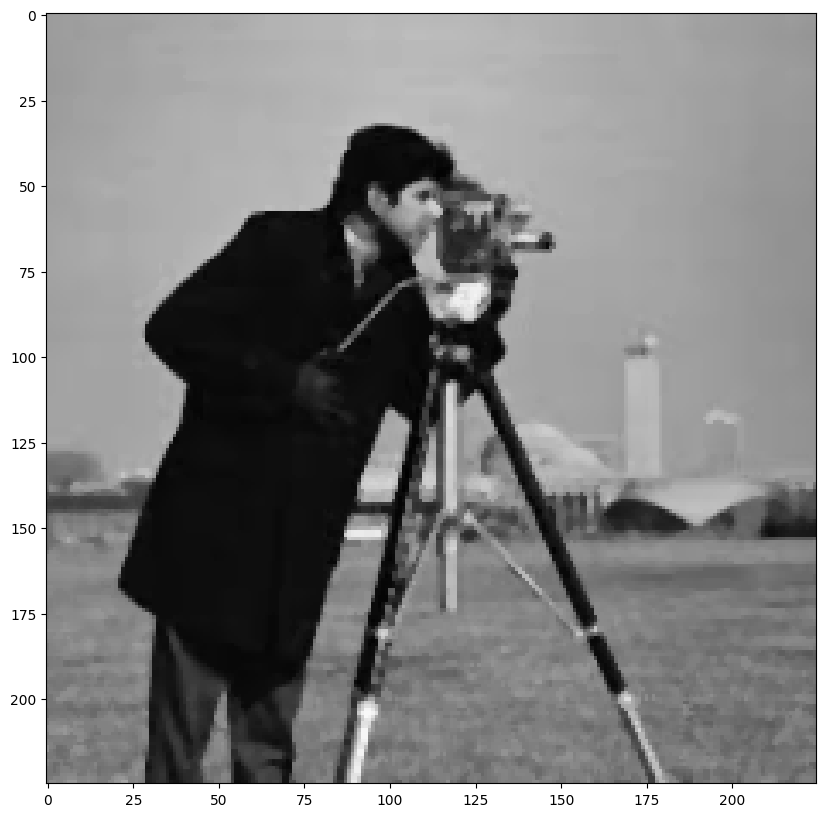

In [23]:
image = image.filter(ImageFilter.MedianFilter)
plt.figure(figsize=(10,10))
# Renders the image
plt.imshow(image,cmap="gray")